In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

In [2]:
import ReadTB
import Plot
import Cluster
import Anova
import ClusterAnalysis

## Feature Engineering
- CSP: customer purchase frequency under promotions
- NB: number of brand being purchased withing 2 years by each customer
- Q: the total purchase amount
- RFB: the ratio of purchase amount of the most purchased brand to total purchase amount
- NOFF: number of brand purchased offline
- NON: number of brand purchased online
- RON: percentage of brand purchased online
- ON: number of online purchase
- PF: monthly purchase frequency

In [3]:
raw_data = pd.read_excel('raw_data.xlsx')
raw_data = raw_data[~raw_data['purchaseLocation'].isin(['giftFromFriend','giftFromCompany'])]

In [4]:
result = ReadTB.DataTB(raw_data)
result.FINAL()

In [5]:
np.random.seed(seed=0)
LEN_ON = len(result.TB_FINAL[result.TB_FINAL['ON']>0])
combine_online_offline = pd.concat([result.TB_FINAL[result.TB_FINAL['ON'] == 0].sample(LEN_ON), result.TB_FINAL[result.TB_FINAL['ON'] > 0]])

In [0]:
demography = raw_data[['city', 'familyIncome', 'familySize']].groupby(raw_data['familyId']).apply(max)
final = pd.concat([combine_online_offline, demography], axis=1, join='inner')

In [3]:
final.to_excel('feature_engineering.xlsx')

NameError: name 'final' is not defined

# Descriptive Statistics

In [4]:
feature_table = pd.read_excel('feature_engineering.xlsx')

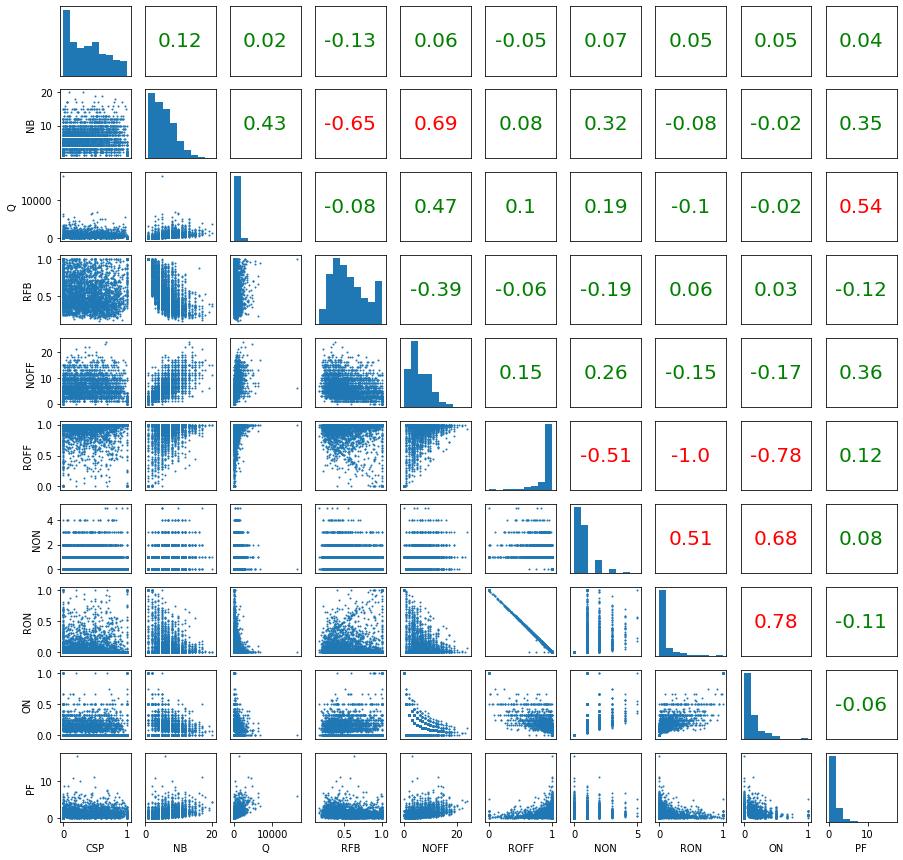

In [5]:
plot_all = Plot.PairPlot(pd_tb=feature_table[feature_table.columns[1:11]], figsize=(15,15))
plot_all.plot()

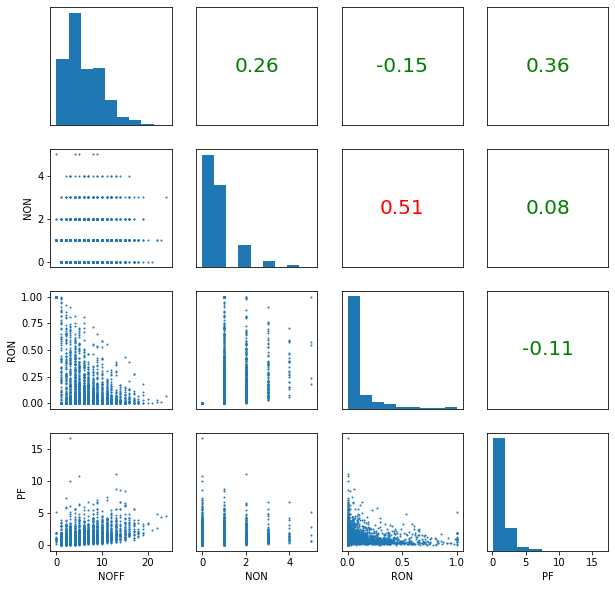

In [6]:
cluster_factors_1 = ['NOFF', 'NON', 'RON', 'PF']
cluster_factors_2 = ['NOFF', 'NON', 'RON']
cluster_factors = [cluster_factors_1, cluster_factors_2]

plot_part_1 = Plot.PairPlot(pd_tb=feature_table[cluster_factors_1])
plot_part_1.plot()

# Clustering Analysis

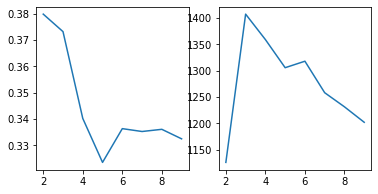

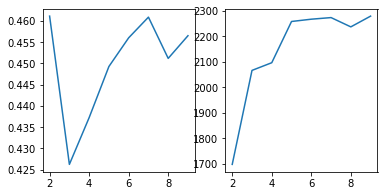

In [7]:
X = [
    np.array([np.array(feature_table[i]) for i in cluster_factors[0]]),
    np.array([np.array(feature_table[i]) for i in cluster_factors[1]])
]
for j in [0, 1]:
    for i in range(len(X[j])):
        X[j][i] = (X[j][i] - X[j][i].mean()) / X[j][i].std()
    X[j] = X[j].T
    Cluster.KMeans(X[j]).test()

Pass: P_NOFF=0.0
Pass: P_NON=0.0
Pass: P_RON=0.0
Pass: P_PF=0.0
Pass: P_NOFF=0.0
Pass: P_NON=0.0
Pass: P_RON=0.0


<Figure size 432x216 with 0 Axes>

<Figure size 432x216 with 0 Axes>

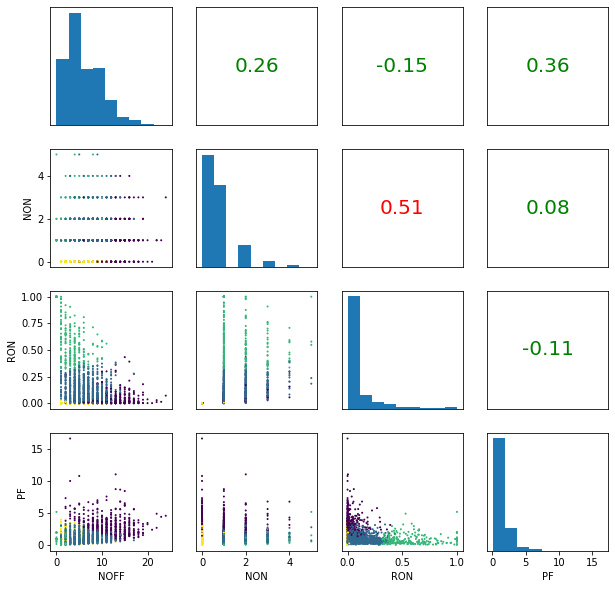

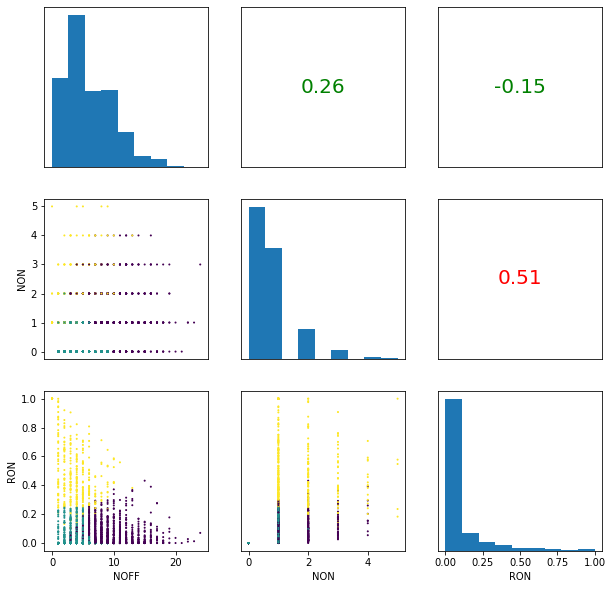

In [8]:
def cluster(obj, tb, n):
    obj.run(n)
    tb_copy = tb.copy()
    tb_copy['y'] = obj.y
    Anova.Anova(tb_copy).run()
    del tb_copy
    return obj.y

def plot(y, cluster_factors):
    pic = Plot.PairPlot(feature_table[cluster_factors],(10,10))
    pic.plot(y)
    return pic

y_km_1 = cluster(Cluster.KMeans(X[0]), feature_table[cluster_factors[0]], len(cluster_factors[0]))
y_km_2 = cluster(Cluster.KMeans(X[1]), feature_table[cluster_factors[1]], len(cluster_factors[1]))
y_km = [y_km_1, y_km_2]
plot(y_km_1, cluster_factors[0])
plot(y_km_2, cluster_factors[1])

# Evaluation & Testing

Pass: P_NOFF=0.0
Pass: P_NON=0.0
Pass: P_RON=0.0
Pass: P_PF=0.0


y_km,0,1,2,3,F_value
Customer Sensitivity of Promotion,0.350,0.372,0.403,0.400,14.192***
Number of Brand Purchased,4.364,6.495,9.343,4.363,325.422***
Number of Offline Brand,4.202,6.288,11.593,3.331,261.78***
Number of Online Brand,0.006,1.324,0.850,1.641,60.289***
Number of Online Purchase,0.002,0.194,0.067,0.412,400.06***
Purchase Frequency,1.016,1.069,3.114,0.909,2578.929***
Total Purchase Amount,315.784,567.850,1460.926,259.752,1831.006***
Ratio of The Most Purchased Brand,0.624,0.520,0.475,0.631,2599.799***
Ratio of Offline Brand,0.999,0.891,0.965,0.418,1944.124***
Ratio of Online Brand,0.000,0.109,0.035,0.582,352.05***


y_km,0,1,2,3,Chi
Shanghai,36.6%,31.6%,24.3%,7.5%,314.871***
Beijing,60.2%,24.6%,8.0%,7.2%,NaN
Guangshen,34.5%,42.9%,12.9%,9.7%,NaN
3001-5000,63.2%,20.7%,8.0%,8.0%,77.476***
5001-7000,55.8%,24.8%,11.9%,7.5%,NaN
7001-9000,49.2%,26.5%,16.8%,7.5%,NaN
<3000,91.7%,0.0%,8.3%,0.0%,NaN
>9000,40.8%,36.0%,15.2%,8.0%,NaN
1,51.9%,29.1%,9.1%,9.8%,41.164***
2,44.4%,33.0%,14.8%,7.8%,NaN


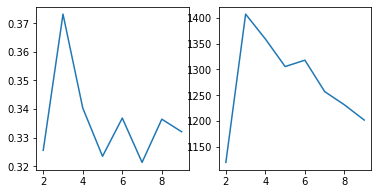

<Figure size 432x216 with 0 Axes>

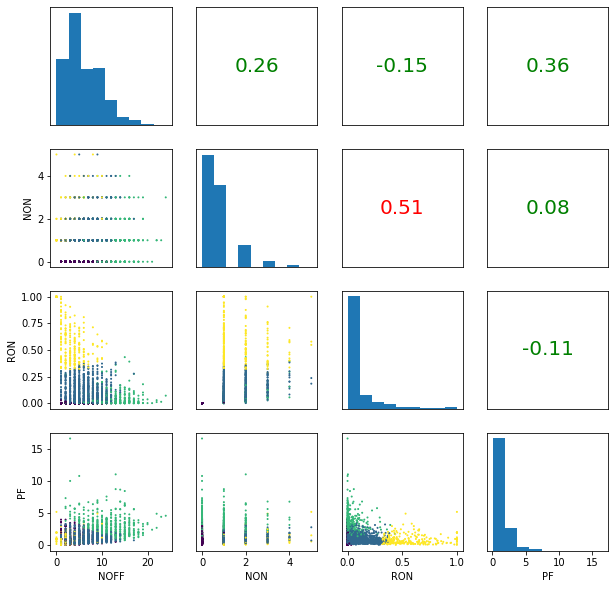

In [9]:
# 4 factors
ClusterAnalysis.Analysis(clusters=4, factors=cluster_factors_1, data=feature_table).run()

Pass: P_NOFF=0.0
Pass: P_NON=0.0
Pass: P_RON=0.0


y_km,0,1,2,3,F_value
Customer Sensitivity of Promotion,0.353,0.393,0.371,0.405,6.135338370417361*
Number of Brand Purchased,4.362,9.098,6.315,4.420,107.98***
Number of Offline Brand,4.119,12.142,5.495,3.355,17.141***
Number of Online Brand,0.000,0.942,1.342,1.658,51.592***
Number of Online Purchase,0.000,0.070,0.213,0.418,21.604***
Purchase Frequency,1.177,2.111,1.207,0.931,3059.336***
Total Purchase Amount,364.541,1130.502,594.431,265.054,4154.608***
Ratio of The Most Purchased Brand,0.626,0.469,0.527,0.633,3084.865***
Ratio of Offline Brand,0.999,0.958,0.882,0.396,5667.398***
Ratio of Online Brand,0.000,0.042,0.118,0.604,1.456


y_km,0,1,2,3,Chi
Shanghai,39.0%,25.1%,29.0%,6.9%,220.866***
Beijing,58.2%,13.9%,21.1%,6.8%,NaN
Guangshen,34.5%,17.0%,39.6%,8.8%,NaN
3001-5000,64.9%,8.6%,18.4%,8.0%,97.04***
5001-7000,57.8%,13.6%,21.4%,7.1%,NaN
7001-9000,48.6%,21.3%,23.1%,6.9%,NaN
<3000,100.0%,0.0%,0.0%,0.0%,NaN
>9000,41.0%,18.4%,33.4%,7.3%,NaN
1,51.9%,11.1%,27.4%,9.6%,48.126***
2,44.9%,18.2%,30.0%,7.0%,NaN


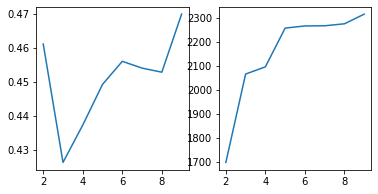

<Figure size 432x216 with 0 Axes>

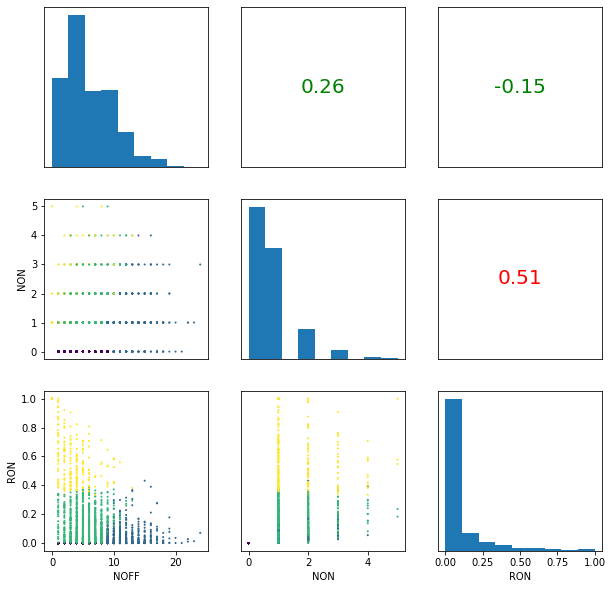

In [10]:
# 3 factors
ClusterAnalysis.Analysis(clusters=4, factors=cluster_factors_2, data=feature_table).run()